In [23]:
import numpy as np
import pandas as pd
import h5py
import matplotlib.pyplot as plt

In [24]:
file_ch0 = "output-wave_0.h5"
file_ch1 = "output-TR.h5"
f_ch0 = h5py.File( file_ch0, 'r')
f_ch1 = h5py.File( file_ch1, 'r')
print ( f_ch0.keys() )
print ( f_ch1.keys() )

<KeysViewHDF5 ['Metadata', 'Waveform']>
<KeysViewHDF5 ['Metadata', 'Waveform']>


In [25]:
dset_ch0 = f_ch0['Waveform']
dset_metadata_ch0 = f_ch0['Metadata']
print( dset_metadata_ch0 )
print ( dset_ch0 )

dset_ch1 = f_ch1['Waveform']
dset_metadata_ch1 = f_ch1['Metadata']
print( dset_metadata_ch1 )
print ( dset_ch1 )

<HDF5 dataset "Metadata": shape (10000, 2), type "<f4">
<HDF5 dataset "Waveform": shape (10000, 1024), type "<f4">
<HDF5 dataset "Metadata": shape (10000, 2), type "<f4">
<HDF5 dataset "Waveform": shape (10000, 1024), type "<f4">


In [26]:
dset_metadata_ch0

<HDF5 dataset "Metadata": shape (10000, 2), type "<f4">

In [27]:
df_ch0 = pd.DataFrame( columns=('Event','Channel','Waveform') )
df_ch0['Event']   = dset_metadata_ch0[:,0].astype('int64')
df_ch0['Channel'] = dset_metadata_ch0[:,1].astype('int64')
for i in range( dset_ch0.shape[0] ):
    df_ch0[ 'Waveform' ].iloc[ i ] = dset_ch0[ i ]
df_ch0 = df_ch0.set_index( 'Event' )
df_ch0

C:\Users\anton\AppData\Local\Temp\ipykernel_15020\1563664108.py:5: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_ch0[ 'Waveform' ].iloc[ i ] = dset_ch0[ i ]
C:\Users\anton\AppData\Local\Temp\ipykernel_15020\1563664108.py:5: SettingWithCop

,Channel,Waveform
Event,,
105661,0,"[2407.0, 2407.0, 2407.9963, 2408.995, 2410.989..."
105662,0,"[2407.0, 2406.9976, 2405.9963, 2405.0134, 2407..."
105663,0,"[2403.0, 2403.0, 2401.0312, 2403.932, 2404.0, ..."
105664,0,"[2418.0, 2418.0063, 2419.0122, 2420.0178, 2421..."
105665,0,"[2413.0, 2413.0, 2414.9927, 2414.0054, 2416.97..."
...,...,...
115656,0,"[2420.0, 2420.0, 2419.0093, 2424.9128, 2425.0,..."
115657,0,"[2422.0, 2421.999, 2421.0044, 2423.021, 2427.9..."
115658,0,"[2415.0, 2414.9968, 2410.9907, 2404.9985, 2404..."


In [29]:
df_ch1 = pd.DataFrame( columns=('Event','Channel','Waveform') )
df_ch1['Event']   = dset_metadata_ch1[:,0].astype('int64')
df_ch1['Channel'] = dset_metadata_ch1[:,1].astype('int64')
for i in range( dset_ch1.shape[0] ):
    df_ch1[ 'Waveform' ].iloc[ i ] = dset_ch1[ i ]
df_ch1 = df_ch1.set_index( 'Event' )
df_ch1

C:\Users\anton\AppData\Local\Temp\ipykernel_15020\449594327.py:5: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_ch1[ 'Waveform' ].iloc[ i ] = dset_ch1[ i ]
C:\Users\anton\AppData\Local\Temp\ipykernel_15020\449594327.py:5: SettingWithCopyW

,Channel,Waveform
Event,,
105661,8,"[2196.0, 2196.0, 2197.9927, 2197.005, 2197.0, ..."
105662,8,"[2197.0, 2197.0, 2196.9927, 2195.009, 2196.989..."
105663,8,"[2198.0, 2198.0, 2198.9844, 2200.9546, 2200.02..."
105664,8,"[2199.0, 2199.0, 2199.0, 2199.0178, 2199.907, ..."
105665,8,"[2197.0, 2197.0, 2197.9963, 2198.9946, 2199.99..."
...,...,...
115656,8,"[2200.0, 2200.0, 2200.9907, 2199.029, 2199.0, ..."
115657,8,"[2195.0, 2195.001, 2195.9978, 2195.0, 2195.006..."
115658,8,"[2198.0, 2197.9993, 2197.0, 2197.0015, 2197.99..."


In [30]:
f_ch0.close()
f_ch1.close()

In [31]:
df_all = df_ch0.join( df_ch1, how='inner', lsuffix='_ch0', rsuffix='_ch1' )
df_all

,Channel_ch0,Waveform_ch0,Channel_ch1,Waveform_ch1
Event,,,,
105661,0,"[2407.0, 2407.0, 2407.9963, 2408.995, 2410.989...",8,"[2196.0, 2196.0, 2197.9927, 2197.005, 2197.0, ..."
105662,0,"[2407.0, 2406.9976, 2405.9963, 2405.0134, 2407...",8,"[2197.0, 2197.0, 2196.9927, 2195.009, 2196.989..."
105663,0,"[2403.0, 2403.0, 2401.0312, 2403.932, 2404.0, ...",8,"[2198.0, 2198.0, 2198.9844, 2200.9546, 2200.02..."
105664,0,"[2418.0, 2418.0063, 2419.0122, 2420.0178, 2421...",8,"[2199.0, 2199.0, 2199.0, 2199.0178, 2199.907, ..."
105665,0,"[2413.0, 2413.0, 2414.9927, 2414.0054, 2416.97...",8,"[2197.0, 2197.0, 2197.9963, 2198.9946, 2199.99..."
...,...,...,...,...
115656,0,"[2420.0, 2420.0, 2419.0093, 2424.9128, 2425.0,...",8,"[2200.0, 2200.0, 2200.9907, 2199.029, 2199.0, ..."
115657,0,"[2422.0, 2421.999, 2421.0044, 2423.021, 2427.9...",8,"[2195.0, 2195.001, 2195.9978, 2195.0, 2195.006..."
115658,0,"[2415.0, 2414.9968, 2410.9907, 2404.9985, 2404...",8,"[2198.0, 2197.9993, 2197.0, 2197.0015, 2197.99..."


In [32]:
events = df_all.index
events

Index([105661, 105662, 105663, 105664, 105665, 105666, 105667, 105668, 105669,
       105670,
       ...
       115651, 115652, 115653, 115654, 115655, 115656, 115657, 115658, 115659,
       115660],
      dtype='int64', name='Event', length=10000)

[2413.     2413.     2412.011  ... 2439.     2438.933  2433.9705]
[2196.     2196.     2195.011  ...  826.9561  825.0536  829.0236]
[  1.2861328   1.2861328   2.2751465 ... -24.713867  -24.646973
 -19.684326 ]
[   2.2634277    2.2634277    3.2524414 ... 1371.3074    1373.2098
 1369.2397   ]


(0.0, 200.0)

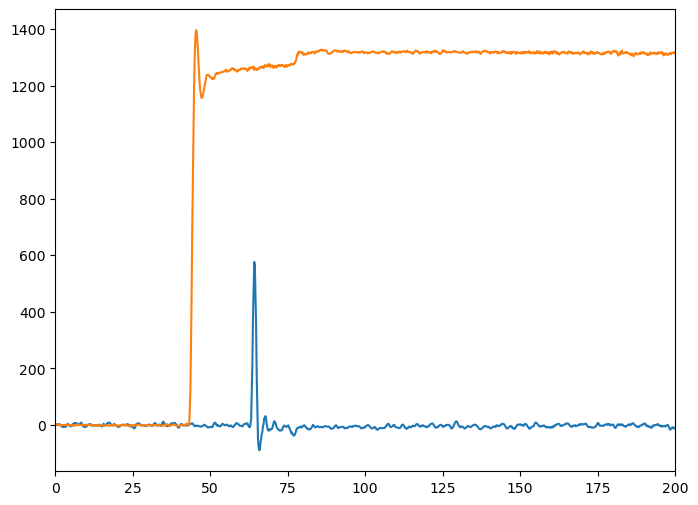

In [33]:
conv = 0.200

i_evt = 10

event_ch0 = df_all.loc[ events[ i_evt ], 'Waveform_ch0' ]
print ( event_ch0 )
event_ch1 = df_all.loc[ events[ i_evt ], 'Waveform_ch1' ]
print ( event_ch1 )

baseline_ch0 = np.mean( event_ch0[:50] )
event_ch0_corr = event_ch0 - baseline_ch0
event_ch0_corr = -event_ch0_corr
print ( event_ch0_corr )

baseline_ch1 = np.mean( event_ch1[:50] )
event_ch1_corr = event_ch1 - baseline_ch1
event_ch1_corr = -event_ch1_corr
print ( event_ch1_corr )

fig = plt.figure( figsize=(8,6) )
X = conv * np.arange( 1024 ) 
plt.plot( X, event_ch0_corr )
plt.plot( X, event_ch1_corr )
plt.xlim(0,200)

(0.0, 200.0)

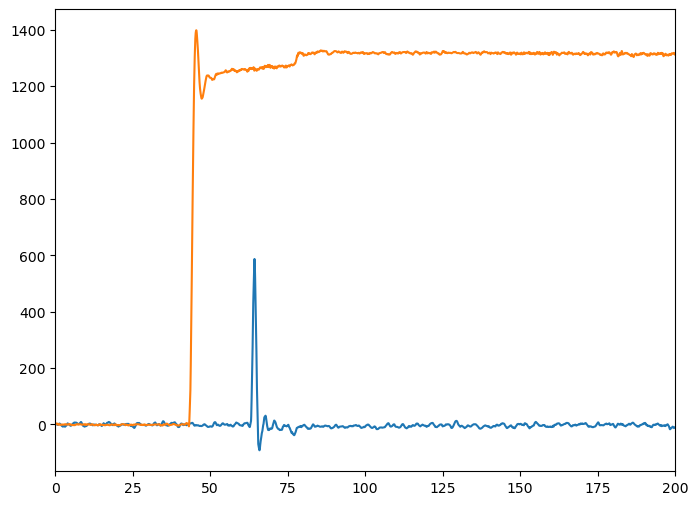

In [34]:
from scipy import interpolate

X_inter = np.linspace( X[0], X[1023], 50*len(X) )

f_ch0 = interpolate.interp1d(X, event_ch0_corr, 'cubic')
y_inter_ch0 = f_ch0( X_inter )

f_ch1 = interpolate.interp1d(X, event_ch1_corr, 'cubic')
y_inter_ch1 = f_ch1( X_inter )

fig = plt.figure( figsize=(8,6) )
plt.plot( X_inter, y_inter_ch0 )
plt.plot( X_inter, y_inter_ch1 )
plt.xlim(0,200)

In [45]:
def corr_wf( event_ ):
    baseline_ = np.mean( event_[:50] )
    event_corr_ = event_ - baseline_
    event_corr_ = -event_corr_
    return event_corr_

[0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150, 160, 170, 180, 190]


Text(0.5, 0, 'CH1')

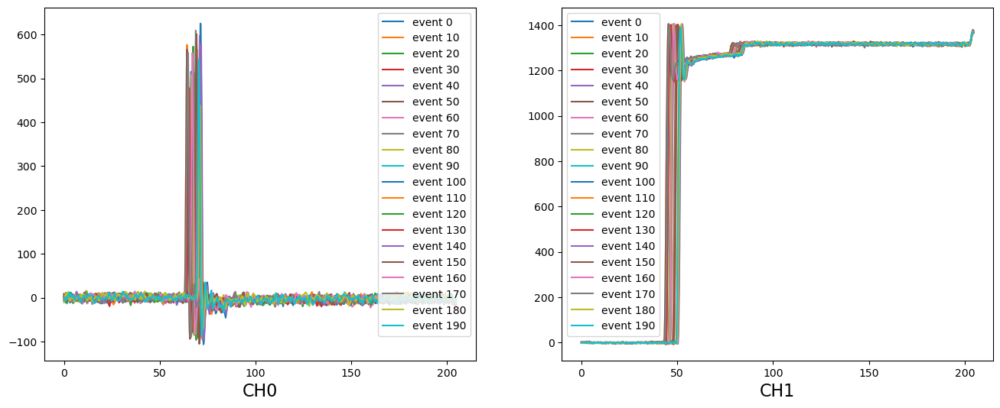

In [50]:
idx_events = range( 0, 200, 10)
print ( list( idx_events ) )

threshold_max_0 = 200 # absolute
threshold_max_1 = 600 # absolute

fig, axes = plt.subplots( 1, 2, figsize=(16,6) )
for i_evt_ in idx_events:    
    event_ch0_ = df_all.loc[ events[ i_evt_ ], "Waveform_ch0" ]
    event_ch1_ = df_all.loc[ events[ i_evt_ ], "Waveform_ch1" ]
    event_ch0_corr_ = corr_wf( event_ch0_ )
    event_ch1_corr_ = corr_wf( event_ch1_ )

    max_ch0_ = np.max( event_ch0_corr_ )
    max_ch1_ = np.max( event_ch1_corr_ )

    if ( max_ch0_ < threshold_max_0 ) or ( max_ch1_ < threshold_max_1 ): continue

    axes[ 0 ].plot( X, event_ch0_corr_, label="event {:d}".format( i_evt_ ) )
    axes[ 1 ].plot( X, event_ch1_corr_, label="event {:d}".format( i_evt_ ) )
    
axes[ 0 ].legend( loc='best' )
axes[ 0 ].set_xlabel( "CH0", fontsize=16 )
axes[ 1 ].legend( loc='best' )
axes[ 1 ].set_xlabel( "CH1", fontsize=16 )

In [58]:
run_interpolation = True
# wave_threshold = 0.50 # relative
wave_threshold_0 = 200 # absolute
wave_threshold_1 = 600 # absolute

max_vals_ch0 = []
max_vals_ch1 = []
risetimes_ch0 = []
risetimes_ch1 = []

X_inter = None
if run_interpolation:
    X_inter = np.linspace( X[0], X[1023], 50*len(X) )

#descarta eventos que tenham zero ou mais de um pico acima do threshold
for evt_ in df_all.index:
    event_ch0_ = df_all.loc[ evt_ , 'Waveform_ch0']
    event_ch1_ = df_all.loc[ evt_ , 'Waveform_ch1']

    event_ch0_corr_ = corr_wf( event_ch0_ )
    event_ch1_corr_ = corr_wf( event_ch1_ )
    
    binX_ch0_ = None
    binX_ch1_ = None
    max_ch0_ = None
    max_ch1_ = None
    if run_interpolation:
        f_ch0_ = interpolate.interp1d(X, event_ch0_corr_, 'cubic')
        y_inter_ch0_ = f_ch0_( X_inter )
        f_ch1_ = interpolate.interp1d(X, event_ch1_corr_, 'cubic')
        y_inter_ch1_ = f_ch1_( X_inter )
        max_ch0_ = np.max( event_ch0_corr_ )
        max_ch1_ = np.max( event_ch1_corr_ )
        # Relative threshold
        # binX_ch0_ = ( y_inter_ch0_ > ( wave_threshold * max_ch0_ ) ).argmax()
        # binX_ch1_ = ( y_inter_ch1_ > ( wave_threshold * max_ch1_ ) ).argmax()
        # Absolute threshold
        binX_ch0_ = ( y_inter_ch0_ > ( wave_threshold_0 ) ).argmax()
        binX_ch1_ = ( y_inter_ch1_ > ( wave_threshold_1 ) ).argmax()
    else:
        max_ch0_ = np.max( event_ch0_corr_ )
        max_ch1_ = np.max( event_ch1_corr_ )
        # Relative threshold
        # binX_ch0_ = ( event_ch0_corr_ > ( wave_threshold * max_ch0_ ) ).argmax()
        # binX_ch1_ = ( event_ch1_corr_ > ( wave_threshold * max_ch1_ ) ).argmax()
        # Absolute threshold
        binX_ch0_ = ( y_inter_ch0_ > ( wave_threshold_0 ) ).argmax()
        binX_ch1_ = ( y_inter_ch1_ > ( wave_threshold_1 ) ).argmax()
    
    if binX_ch0_ > 0 and binX_ch1_ > 0:
        max_vals_ch0.append( max_ch0_ )
        max_vals_ch1.append( max_ch1_ )
        if run_interpolation:
            risetimes_ch0.append( X_inter[ binX_ch0_ ] )
            risetimes_ch1.append( X_inter[ binX_ch1_ ] )
        else:
            risetimes_ch0.append( X[ binX_ch0_ ] )
            risetimes_ch1.append( X[ binX_ch1_ ] )

max_vals_ch0 = np.array( max_vals_ch0 )
max_vals_ch1 = np.array( max_vals_ch1 )
risetimes_ch0 = np.array( risetimes_ch0 )
risetimes_ch1 = np.array( risetimes_ch1 )

print ( max_vals_ch0 )
print ( max_vals_ch1 )
print ( risetimes_ch0 )
print ( risetimes_ch1 )
print ( len(risetimes_ch0) )
print ( len(risetimes_ch1) )

[515.59814 596.0902  476.83167 ... 581.083   421.47144 619.2085 ]
[1397.1587 1397.1882 1406.1648 ... 1397.6188 1390.8916 1407.9626]
[65.60914862 66.31647102 67.13169007 ... 66.37241743 67.03578195
 67.49933788]
[46.20773453 46.99498037 47.68631809 ... 46.92304928 47.53046739
 48.05796207]
10000
10000


[19.40141409 19.32149065 19.44537198 ... 19.44936815 19.50531456
 19.44137581]


(array([  2.,   5.,  18.,  18.,  49.,  88., 162., 165., 307., 439., 594.,
        462., 771., 946., 935., 624., 961., 807., 716., 406., 507., 393.,
        238., 130., 110.,  72.,  34.,  16.,  14.,   5.,   2.,   1.,   2.,
          0.,   1.]),
 array([19.26154808, 19.27250901, 19.28346993, 19.29443086, 19.30539179,
        19.31635272, 19.32731365, 19.33827458, 19.3492355 , 19.36019643,
        19.37115736, 19.38211829, 19.39307922, 19.40404015, 19.41500107,
        19.425962  , 19.43692293, 19.44788386, 19.45884479, 19.46980572,
        19.48076664, 19.49172757, 19.5026885 , 19.51364943, 19.52461036,
        19.53557129, 19.54653221, 19.55749314, 19.56845407, 19.579415  ,
        19.59037593, 19.60133686, 19.61229778, 19.62325871, 19.63421964,
        19.64518057]),
 <BarContainer object of 35 artists>)

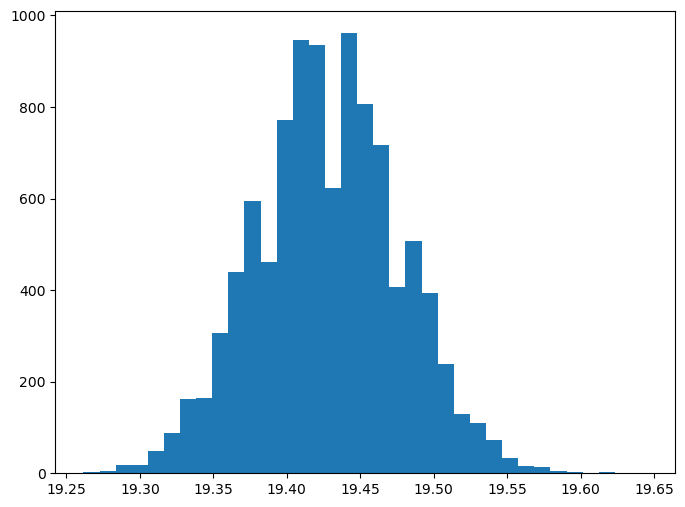

In [60]:
fig = plt.figure( figsize=(8,6) )
diff_times = ( risetimes_ch0 - risetimes_ch1 )
print ( diff_times )
plt.hist( diff_times, bins=35 )